# IEEE Fraud Detection Kaggle Competition

In [890]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import lightgbm as lgb
from sklearn.metrics import roc_auc_score
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.preprocessing import LabelEncoder

In [891]:
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

num_folds = 5
SEED = 5000

In [892]:
import random, os
def seed_everything(seed=SEED):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    
seed_everything()

In [893]:
sampled_train_original = pd.read_csv('../../output/sampled_train_reduced_mem.csv')

In [894]:
train = pd.read_csv('../../output/train_reduced_mem.csv')
test = pd.read_csv('../../output/test_reduced_mem.csv')

In [895]:
def reduce_mem_usage(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2    
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)    
    end_mem = df.memory_usage().sum() / 1024**2
    if verbose: 
        print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return df

In [896]:
# sampled_train_original = reduce_mem_usage(sampled_train_original)

In [897]:
params = {
                'objective':'binary',
                'boosting_type':'gbdt',
                'metric':'auc',
                'n_jobs':-1,
                'learning_rate':0.064,
                'num_leaves': 2**8,
                'max_depth':-1,
                'tree_learner':'serial',
                'colsample_bytree': 0.85,
                'subsample_freq':1,
                'subsample':0.85,
                'max_bin':255,
                'verbose':-1,
                'seed': SEED,
                'reg_alpha':0.3,
                'reg_lambda':0.243
            } 
# Uses a lower learning rate - default is 0.1. This is not changed in my notebooks, try again with this change?
# params['learning_rate'] = 0.005
params['learning_rate'] = 0.01
# params['n_estimators'] = 3000
params['n_estimators'] = 550
# params['early_stopping_rounds'] = 100    

In [898]:
sampled_train_original.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_18,id_19,id_20,id_21,id_22,id_23,id_24,id_25,id_26,id_27,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek
0,2996780,0,302413,25.98,C,4461,375.0,185.0,mastercard,224.0,debit,NaN,NaN,NaN,NaN,gmail.com,gmail.com,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,M2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0000,0.0000,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0000,0.0000,0.0000,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0000,0.0000,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,334122.0,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,100.0,NotFound,NaN,NaN,New,NotFound,225.0,NaN,266.0,325.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,chrome 62.0 for android,NaN,NaN,NaN,F,F,T,T,mobile,F3213 Build/36.1.

In [899]:
n_days_in_week_21 = 18509

In [900]:
"""
This module provides a class to split time-series data for back-testing and evaluation.
The aim was to extend the current sklearn implementation and extend it's uses.

Might be useful for some ;)
"""

import logging
from typing import Optional

import numpy as np
from sklearn.model_selection._split import _BaseKFold
from sklearn.utils import indexable
from sklearn.utils.validation import _num_samples

LOGGER = logging.getLogger(__name__)


class TimeSeriesSplit(_BaseKFold):  # pylint: disable=abstract-method
    """Time Series cross-validator

    Provides train/test indices to split time series data samples that are observed at fixed time intervals,
    in train/test sets. In each split, test indices must be higher than before, and thus shuffling in cross validator is
    inappropriate.

    This cross_validation object is a variation of :class:`TimeSeriesSplit` from the popular scikit-learn package.
    It extends its base functionality to allow for expanding windows, and rolling windows with configurable train and
    test sizes and delays between each. i.e. train on weeks 1-8, skip week 9, predict week 10-11.

    In this implementation we specifically force the test size to be equal across all splits.

    Expanding Window:

            Idx / Time  0..............................................n
            1           |  train  | delay |  test  |                   |
            2           |       train     | delay  |  test  |          |
            ...         |                                              |
            last        |            train            | delay |  test  |

    Rolling Windows:
            Idx / Time  0..............................................n
            1           | train   | delay |  test  |                   |
            2           | step |  train  | delay |  test  |            |
            ...         |                                              |
            last        | step | ... | step |  train  | delay |  test  |

    Parameters:
        n_splits : int, default=5
            Number of splits. Must be at least 4.

        train_size : int, optional
            Size for a single training set.

        test_size : int, optional, must be positive
            Size of a single testing set

        delay : int, default=0, must be positive
            Number of index shifts to make between train and test sets
            e.g,
            delay=0
                TRAIN: [0 1 2 3] TEST: [4]
            delay=1
                TRAIN: [0 1 2 3] TEST: [5]
            delay=2
                TRAIN: [0 1 2 3] TEST: [6]

        force_step_size : int, optional
            Ignore split logic and force the training data to shift by the step size forward for n_splits
            e.g
            TRAIN: [ 0  1  2  3] TEST: [4]
            TRAIN: [ 0  1  2  3  4] TEST: [5]
            TRAIN: [ 0  1  2  3  4  5] TEST: [6]
            TRAIN: [ 0  1  2  3  4  5  6] TEST: [7]

    Examples
    --------
    >>> X = np.array([[1, 2], [3, 4], [1, 2], [3, 4], [1, 2], [3, 4]])
    >>> y = np.array([1, 2, 3, 4, 5, 6])
    >>> tscv = TimeSeriesSplit(n_splits=5)
    >>> print(tscv)  # doctest: +NORMALIZE_WHITESPACE
    TimeSeriesSplit(train_size=None, n_splits=5)
    >>> for train_index, test_index in tscv.split(X):
    ...    print('TRAIN:', train_index, 'TEST:', test_index)
    ...    X_train, X_test = X[train_index], X[test_index]
    ...    y_train, y_test = y[train_index], y[test_index]
    TRAIN: [0] TEST: [1]
    TRAIN: [0 1] TEST: [2]
    TRAIN: [0 1 2] TEST: [3]
    TRAIN: [0 1 2 3] TEST: [4]
    TRAIN: [0 1 2 3 4] TEST: [5]
    """

    def __init__(self,
                 n_splits: Optional[int] = 5,
                 train_size: Optional[int] = None,
                 test_size: Optional[int] = None,
                 delay: int = 0,
                 force_step_size: Optional[int] = None):

        if n_splits and n_splits < 5:
            raise ValueError(f'Cannot have n_splits less than 5 (n_splits={n_splits})')
        super().__init__(n_splits, shuffle=False, random_state=None)

        self.train_size = train_size

        if test_size and test_size < 0:
            raise ValueError(f'Cannot have negative values of test_size (test_size={test_size})')
        self.test_size = test_size

        if delay < 0:
            raise ValueError(f'Cannot have negative values of delay (delay={delay})')
        self.delay = delay

        if force_step_size and force_step_size < 1:
            raise ValueError(f'Cannot have zero or negative values of force_step_size '
                             f'(force_step_size={force_step_size}).')

        self.force_step_size = force_step_size

    def split(self, X, y=None, groups=None):
        """Generate indices to split data into training and test set.

        Parameters:
            X : array-like, shape (n_samples, n_features)
                Training data, where n_samples is the number of samples  and n_features is the number of features.

            y : array-like, shape (n_samples,)
                Always ignored, exists for compatibility.

            groups : array-like, with shape (n_samples,), optional
                Always ignored, exists for compatibility.

        Yields:
            train : ndarray
                The training set indices for that split.

            test : ndarray
                The testing set indices for that split.
        """
        X, y, groups = indexable(X, y, groups)  # pylint: disable=unbalanced-tuple-unpacking
        n_samples = _num_samples(X)
        n_splits = self.n_splits
        n_folds = n_splits + 1
        delay = self.delay

        if n_folds > n_samples:
            raise ValueError(f'Cannot have number of folds={n_folds} greater than the number of samples: {n_samples}.')

        indices = np.arange(n_samples)
        split_size = n_samples // n_folds

        train_size = self.train_size or split_size * self.n_splits
        test_size = self.test_size or n_samples // n_folds
        full_test = test_size + delay

        if full_test + n_splits > n_samples:
            raise ValueError(f'test_size\\({test_size}\\) + delay\\({delay}\\) = {test_size + delay} + '
                             f'n_splits={n_splits} \n'
                             f' greater than the number of samples: {n_samples}. Cannot create fold logic.')

        # Generate logic for splits.
        # Overwrite fold test_starts ranges if force_step_size is specified.
        if self.force_step_size:
            step_size = self.force_step_size
            final_fold_start = n_samples - (train_size + full_test)
            range_start = (final_fold_start % step_size) + train_size

            test_starts = range(range_start, n_samples, step_size)

        else:
            if not self.train_size:
                step_size = split_size
                range_start = (split_size - full_test) + split_size + (n_samples % n_folds)
            else:
                step_size = (n_samples - (train_size + full_test)) // n_folds
                final_fold_start = n_samples - (train_size + full_test)
                range_start = (final_fold_start - (step_size * (n_splits - 1))) + train_size

            test_starts = range(range_start, n_samples, step_size)

        # Generate data splits.
        for test_start in test_starts:
            idx_start = test_start - train_size if self.train_size is not None else 0
            # Ensure we always return a test set of the same size
            if indices[test_start:test_start + full_test].size < full_test:
                continue
            yield (indices[idx_start:test_start],
                   indices[test_start + delay:test_start + full_test])

# Feature Engineering

In [901]:
sampled_train_original.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_18,id_19,id_20,id_21,id_22,id_23,id_24,id_25,id_26,id_27,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek
0,2996780,0,302413,25.98,C,4461,375.0,185.0,mastercard,224.0,debit,NaN,NaN,NaN,NaN,gmail.com,gmail.com,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,M2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0000,0.0000,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0000,0.0000,0.0000,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0000,0.0000,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,334122.0,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,100.0,NotFound,NaN,NaN,New,NotFound,225.0,NaN,266.0,325.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,chrome 62.0 for android,NaN,NaN,NaN,F,F,T,T,mobile,F3213 Build/36.1.

In [902]:
one_value_cols = [col for col in train.columns if train[col].nunique() <= 1]
one_value_cols_test = [col for col in test.columns if test[col].nunique() <= 1]

many_null_cols = [col for col in train.columns if train[col].isnull().sum() / train.shape[0] > 0.9]
many_null_cols_test = [col for col in test.columns if test[col].isnull().sum() / test.shape[0] > 0.9]

big_top_value_cols = [col for col in train.columns if train[col].value_counts(dropna=False, normalize=True).values[0] > 0.9]
big_top_value_cols_test = [col for col in test.columns if test[col].value_counts(dropna=False, normalize=True).values[0] > 0.9]

cols_to_drop = list(set(many_null_cols + many_null_cols_test + big_top_value_cols + big_top_value_cols_test + one_value_cols + one_value_cols_test))
cols_to_drop.remove('isFraud')
print('{} features are going to be dropped for being useless'.format(len(cols_to_drop)))

sampled_train_original = sampled_train_original.drop(cols_to_drop, axis=1)
train_original = train.drop(cols_to_drop, axis=1)
test_original = test.drop(cols_to_drop, axis=1)

82 features are going to be dropped for being useless


In [903]:
important_features = [features.rstrip('\n') for features in open('../../output/important_features_from_RFE.txt')]
features_to_drop = [feature for feature in list(train_original) if feature not in important_features + ['isFraud']]

important_features_2 = [features.rstrip('\n') for features in open('../../output/important_features_from_RFE_2.txt')]
features_to_drop_2 = [feature for feature in list(test_original) if feature not in important_features_2 + ['isFraud']]

In [904]:
sampled_train = sampled_train_original.copy()
train = train_original.copy()
test = test_original.copy()

In [905]:
sampled_train.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V15,V16,V17,V18,V19,V20,V21,V22,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V56,V57,V58,V59,V60,V61,V62,V63,V64,V69,V70,V71,V72,V73,V74,V75,V76,V78,V79,V80,V81,V82,V83,V84,V85,V87,V90,V91,V92,V93,V94,V95,V96,V97,V99,V100,V126,V127,V128,V130,V131,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V282,V283,V285,V287,V288,V289,V291,V292,V294,V302,V303,V304,V306,V307,V308,V310,V312,V313,V314,V315,V317,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek
0,2996780,0,302413,25.98,C,4461,375.0,185.0,mastercard,224.0,debit,NaN,NaN,NaN,gmail.com,gmail.com,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,M2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0000,0.0000,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0000,0.0000,0.0000,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0000,0.0000,0.0000,0.00,0.00,0.00,0.00,0.00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,334122.0,NaN,NaN,0.0,0.0,NaN,NaN,100.0,NotFound,NaN,NaN,New,NotFound,225.0,266.0,325.0,New,NotFound,NaN,chrome 62.0 for android,NaN,NaN,NaN,F,F,T,T,mobile,F3213 Build/36.1.A.1.86,1.0
1,2996781,0,302415,250.00,R,13979,474.0,150.0,visa,226.0,credit,476.0,87.0,NaN,yahoo.com,anonymous.com,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [906]:
# features_with_dissimilar_dists = [ C4', 'C7', 
#                                   'C8', 'C9', 'C10', 'C12', 'C14', 'D2', 'D3', 'D6', 'D11',
#                                   'D12', 'D13', 'D14', 'D15', 'V30', 'V45', 'V70', 'V71',
#                                   'V78', 'V87', 'V91', 'V92', 'V95', 'V96', 'V97', 'V99',
#                                   'V126', 'V127', 'V128', 'V130', 'V131', 'V144',
#                                   'V145', 'V159', 'V160', 'V162', 'V163', 'V164', 'V165',
#                                   'V166', 'V167', 'V168', 'V171', 'V176', 'V178', 'V179']

# features_with_dissimilar_dists = ['C8', 'C9', 'C10', 'C12', 'D6']

In [907]:
valid_card = train['card1'].value_counts()
valid_card = valid_card[valid_card>10]
valid_card = list(valid_card.index)

sampled_train['card1'] = np.where(sampled_train['card1'].isin(valid_card), sampled_train['card1'], np.nan)
train['card1'] = np.where(train['card1'].isin(valid_card), train['card1'], np.nan)
test['card1'] = np.where(test['card1'].isin(valid_card), test['card1'], np.nan)

In [908]:
########################### Device info
for df in [sampled_train, train, test]:
    ########################### Device info
    df['DeviceInfo'] = df['DeviceInfo'].fillna('unknown_device').str.lower()
    df['DeviceInfo_device'] = df['DeviceInfo'].apply(lambda x: ''.join([i for i in x if i.isalpha()]))
    
    ########################### Device info 2
    df['id_30'] = df['id_30'].fillna('unknown_device').str.lower()
    df['id_30_device'] = df['id_30'].apply(lambda x: ''.join([i for i in x if i.isalpha()]))
    df['id_30_version'] = df['id_30'].apply(lambda x: ''.join([i for i in x if i.isnumeric()]))
    
    ########################### Browser
    df['id_31'] = df['id_31'].fillna('unknown_device').str.lower()
    df['id_31_device'] = df['id_31'].apply(lambda x: ''.join([i for i in x if i.isalpha()]))

In [909]:
from sklearn.preprocessing import LabelEncoder

for col in list(train):
    if train[col].dtype=='O':
        print(col)
        sampled_train[col] = sampled_train[col].fillna('unseen_before_label')
        train[col] = train[col].fillna('unseen_before_label')
        test[col]  = test[col].fillna('unseen_before_label')
        
        sampled_train[col] = sampled_train[col].astype(str)
        train[col] = train[col].astype(str)
        test[col] = test[col].astype(str)
        
        le = LabelEncoder()
        le.fit(list(train[col])+list(test[col]))
        sampled_train[col] = le.transform(sampled_train[col])
        train[col] = le.transform(train[col])
        test[col] = le.transform(test[col])

ProductCD
card4
card6
P_emaildomain
R_emaildomain
M1
M2
M3
M4
M5
M6
M7
M8
M9
id_12
id_15
id_16
id_28
id_29
id_30
id_31
id_33
id_34
id_35
id_36
id_37
id_38
DeviceType
DeviceInfo
DeviceInfo_device
id_30_device
id_30_version
id_31_device


In [910]:
########################### M columns (except M4)
# All these columns are binary encoded 1/0
# We can have some features from it
i_cols = ['M1','M2','M3','M5','M6','M7','M8','M9']

for df in [sampled_train, train, test]:
    df['M_mean'] = df[i_cols].mean(axis=1).astype(np.int8)
    df['M_sum'] = df[i_cols].sum(axis=1).astype(np.int8)

In [911]:
sampled_train['uid'] = sampled_train['card1'].astype(str) + '_' + sampled_train['card2'].astype(str) + '_' + sampled_train['card3'].astype(str) + '_' + \
               sampled_train['card4'].astype(str)
train['uid'] = train['card1'].astype(str) + '_' + train['card2'].astype(str) + '_' + train['card3'].astype(str) + '_' + \
               train['card4'].astype(str)
test['uid'] = test['card1'].astype(str) + '_' + test['card2'].astype(str) + '_' + test['card3'].astype(str) + '_' + \
              test['card4'].astype(str)

sampled_train['uid2'] = sampled_train['uid'].astype(str) + '_' + sampled_train['addr1'].astype(str) + '_' + sampled_train['addr2'].astype(str)
train['uid2'] = train['uid'].astype(str) + '_' + train['addr1'].astype(str) + '_' + train['addr2'].astype(str)
test['uid2'] = test['uid'].astype(str) + '_' + test['addr1'].astype(str) + '_' + test['addr2'].astype(str)

sampled_train['TransactionAmt_check'] = np.where(sampled_train['TransactionAmt'].isin(test['TransactionAmt']), 1, 0)
train['TransactionAmt_check'] = np.where(train['TransactionAmt'].isin(test['TransactionAmt']), 1, 0)
test['TransactionAmt_check']  = np.where(test['TransactionAmt'].isin(train['TransactionAmt']), 1, 0)

i_cols = ['card2', 'card3', 'card5', 'uid', 'uid2']

for col in i_cols:
    for agg_type in ['mean', 'std']:
        new_col_name = col+'_TransactionAmt_'+agg_type
        temp_df = pd.concat([train[[col, 'TransactionAmt']], test[[col,'TransactionAmt']]])
        temp_df = temp_df.groupby([col])['TransactionAmt'].agg([agg_type]).reset_index().rename(
                                                columns={agg_type: new_col_name})
        
        temp_df.index = list(temp_df[col])
        temp_df = temp_df[new_col_name].to_dict()   
        
        sampled_train[new_col_name] = sampled_train[col].map(temp_df)
        train[new_col_name] = train[col].map(temp_df)
        test[new_col_name] = test[col].map(temp_df)

In [912]:
for month in np.ceil(pd.concat([train['TransactionDT'], test['TransactionDT']]) / (60*60*24*30)).unique():
    for col in ['card1']:
        for agg_type in ['mean', 'std']:
            new_col_name = col+'_TransactionAmt_'+ agg_type + '_over_' + str(month) + '_month(s)'
            temp_df = pd.concat([train[[col, 'TransactionAmt', 'TransactionDT']],
                                 test[[col, 'TransactionAmt', 'TransactionDT']]])
            temp_df = temp_df[temp_df['TransactionDT'] < train['TransactionDT'][0] + month*(60*60*24*30)]
            temp_df = temp_df.groupby([col])['TransactionAmt'].agg([agg_type]).reset_index().rename(
                                                    columns={agg_type: new_col_name})

            temp_df.index = list(temp_df[col])
            temp_df = temp_df[new_col_name].to_dict()
            
            sampled_train[new_col_name] = sampled_train[col].map(temp_df)
            train[new_col_name] = train[col].map(temp_df)
            test[new_col_name] = test[col].map(temp_df)
            
#             new_col_name = col+'_TransactionAmt_'+ agg_type + '_for_month_' + str(month)
#             temp_df = pd.concat([train[[col, 'TransactionAmt', 'TransactionDT']],
#                                  test[[col, 'TransactionAmt', 'TransactionDT']]])
#             temp_df = temp_df[(temp_df['TransactionDT'] > train['TransactionDT'][0] + (month-1)*(60*60*24*30)) &
#                               (temp_df['TransactionDT'] < train['TransactionDT'][0] + month*(60*60*24*30))]
#             temp_df = temp_df.groupby([col])['TransactionAmt'].agg([agg_type]).reset_index().rename(
#                                                     columns={agg_type: new_col_name})

#             temp_df.index = list(temp_df[col])
#             temp_df = temp_df[new_col_name].to_dict()
            
#             sampled_train[new_col_name] = sampled_train[col].map(temp_df)
#             train[new_col_name] = train[col].map(temp_df)
#             test[new_col_name] = test[col].map(temp_df)

In [913]:
sampled_train.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V15,V16,V17,V18,V19,V20,V21,V22,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V56,V57,V58,V59,V60,V61,V62,V63,V64,V69,V70,V71,V72,V73,V74,V75,V76,V78,V79,V80,V81,V82,V83,V84,V85,V87,V90,V91,V92,V93,V94,V95,V96,V97,V99,V100,V126,V127,V128,V130,V131,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V282,V283,V285,V287,V288,V289,V291,V292,V294,V302,V303,V304,V306,V307,V308,V310,V312,V313,V314,V315,V317,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek,DeviceInfo_device,id_30_device,id_30_version,id_31_device,M_mean,M_sum,uid,uid2,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card3_TransactionAmt_std,card5_TransactionAmt_mean,card5_TransactionAmt_std,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_TransactionAmt_mean_over_4.0_month(s),card1_TransactionAmt_std_over_4.0_month(s),card1_TransactionAmt_mean_over_5.0_month(s),card1_TransactionAmt_std_over_5.0_month(s),card1_TransactionAmt_mean_over_6.0_month(s),card1_TransactionAmt_std_over_6.0_month(s),card1_TransactionAmt_mean_over_7.0_month(s),card1_TransactionAmt_std_over_7.0_month(s),card1_TransactionAmt_mean_over_8.0_month(s),card1_TransactionAmt_std_over_8.0_month(s),card1_TransactionAmt_mean_over_9.0_month(s),card1_TransactionAmt_std_over_9.0_month(s),card1_TransactionAmt_mean_over_10.0_month(s),card1_TransactionAmt_std_over_10.0_month(s),card1_TransactionAmt_mean_over_11.0_month(s),card1_TransactionAmt_std_over_11.0_month(s),card1_TransactionAmt_mean_over_12.0_month(s),card1_TransactionAmt_std_over_12.0_month(s),card1_TransactionAmt_mean_over_13.0_month(s),card1_TransactionAmt_std_over_13.0_month(s),card1_TransactionAmt_mean_over_14.0_month(s),card1_TransactionAmt_std_over_14.0_month(s)
0,2996780,0,302413,25.98,0,4461.0,375.0,185.0,2,224.0,2,NaN,NaN,NaN,16,16,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.0,2,2,2,2,2,2,2,2,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.

In [914]:
i_cols = ['card1','card2','card3','card5',
          'C1','C2','C4','C5','C6','C7','C8','C9','C10','C11','C12','C13','C14',
          'D1','D2','D3','D4','D5','D6','D8','D9',
          'addr1',
          'dist1',
          'P_emaildomain', 'R_emaildomain',
          'DeviceType', 'DeviceInfo','DeviceInfo_device',
          'id_30','id_30_device','id_30_version',
          'id_31_device',
          'id_33',
          'uid','uid2',
         ]

for col in i_cols:
    temp_df = pd.concat([train[[col]], test[[col]]])
    fq_encode = temp_df[col].value_counts().to_dict()   
    
    sampled_train[col+'_fq_enc'] = sampled_train[col].map(fq_encode)
    train[col+'_fq_enc'] = train[col].map(fq_encode)
    test[col+'_fq_enc'] = test[col].map(fq_encode)

In [915]:
sampled_train['bank_type'] = sampled_train['card3'].astype(str)+'_'+sampled_train['card5'].astype(str)
train['bank_type'] = train['card3'].astype(str)+'_'+train['card5'].astype(str)
test['bank_type']  = test['card3'].astype(str)+'_'+test['card5'].astype(str)

sampled_train['address_match'] = sampled_train['bank_type'].astype(str)+'_'+sampled_train['addr2'].astype(str)
train['address_match'] = train['bank_type'].astype(str)+'_'+train['addr2'].astype(str)
test['address_match']  = test['bank_type'].astype(str)+'_'+test['addr2'].astype(str)

for col in ['address_match','bank_type']:
    temp_df = pd.concat([train[[col]], test[[col]]])
    temp_df[col] = np.where(temp_df[col].str.contains('nan'), np.nan, temp_df[col])
    temp_df = temp_df.dropna()
    fq_encode = temp_df[col].value_counts().to_dict()   
    sampled_train[col] = sampled_train[col].map(fq_encode)
    train[col] = train[col].map(fq_encode)
    test[col] = test[col].map(fq_encode)
    
sampled_train['address_match'] = sampled_train['address_match']/sampled_train['bank_type'] 
train['address_match'] = train['address_match']/train['bank_type'] 
test['address_match'] = test['address_match']/test['bank_type'] 

In [916]:
sampled_train['TransactionAmt'] = np.log1p(sampled_train['TransactionAmt'])
train['TransactionAmt'] = np.log1p(train['TransactionAmt'])
test['TransactionAmt'] = np.log1p(test['TransactionAmt'])

In [917]:
sampled_train.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V15,V16,V17,V18,V19,V20,V21,V22,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V56,V57,V58,V59,V60,V61,V62,V63,V64,V69,V70,V71,V72,V73,V74,V75,V76,V78,V79,V80,V81,V82,V83,V84,V85,V87,V90,V91,V92,V93,V94,V95,V96,V97,V99,V100,V126,V127,V128,V130,V131,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V282,V283,V285,V287,V288,V289,V291,V292,V294,V302,V303,V304,V306,V307,V308,V310,V312,V313,V314,V315,V317,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek,DeviceInfo_device,id_30_device,id_30_version,id_31_device,M_mean,M_sum,uid,uid2,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card3_TransactionAmt_std,card5_TransactionAmt_mean,card5_TransactionAmt_std,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_TransactionAmt_mean_over_4.0_month(s),card1_TransactionAmt_std_over_4.0_month(s),card1_TransactionAmt_mean_over_5.0_month(s),card1_TransactionAmt_std_over_5.0_month(s),card1_TransactionAmt_mean_over_6.0_month(s),card1_TransactionAmt_std_over_6.0_month(s),card1_TransactionAmt_mean_over_7.0_month(s),card1_TransactionAmt_std_over_7.0_month(s),card1_TransactionAmt_mean_over_8.0_month(s),card1_TransactionAmt_std_over_8.0_month(s),card1_TransactionAmt_mean_over_9.0_month(s),card1_TransactionAmt_std_over_9.0_month(s),card1_TransactionAmt_mean_over_10.0_month(s),card1_TransactionAmt_std_over_10.0_month(s),card1_TransactionAmt_mean_over_11.0_month(s),card1_TransactionAmt_std_over_11.0_month(s),card1_TransactionAmt_mean_over_12.0_month(s),card1_TransactionAmt_std_over_12.0_month(s),card1_TransactionAmt_mean_over_13.0_month(s),card1_TransactionAmt_std_over_13.0_month(s),card1_TransactionAmt_mean_over_14.0_month(s),card1_TransactionAmt_std_over_14.0_month(s),card1_fq_enc,card2_fq_enc,card3_fq_enc,card5_fq_enc,C1_fq_enc,C2_fq_enc,C4_fq_enc,C5_fq_enc,C6_fq_enc,C7_fq_enc,C8_fq_enc,C9_fq_enc,C10_fq_enc,C11_fq_enc,C12_fq_enc,C13_fq_enc,C14_fq_enc,D1_fq_enc,D2_fq_enc,D3_fq_enc,D4_fq_enc,D5_fq_enc,D6_fq_enc,D8_fq_enc,D9_fq_enc,addr1_fq_enc,dist1_fq_enc,P_emaildomain_fq_enc,R_emaildomain_fq_enc,DeviceType_fq_enc,DeviceInfo_fq_enc,DeviceInfo_device_fq_enc,id_30_fq_enc,id_30_device_fq_enc,id_30_version_fq_enc,id_31_device_fq_enc,id_33_fq_enc,uid_fq_enc,uid2_fq_enc,bank_type,address_match
0,2996780,0,302413,3.295096,0,4461.0,375.0,185.0,2,224.0,2,NaN,NaN,NaN,16,16,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,0.0

In [918]:
# plt.figure(figsize=(12,8))

# sns.distplot(train[(train['address_match'].isna()==False) & (train[train['address_match'].isna()==False]['isFraud'] == 0)]['address_match'], hist=False, label='not fraud')
# sns.distplot(train[(train['address_match'].isna()==False) & (train[train['address_match'].isna()==False]['isFraud'] == 1)]['address_match'], hist=False, label='fraud')

# plt.legend()

# plt.figure(figsize=(12,8))

# sns.distplot(train[train['address_match'].isna()==False]['address_match'], hist=False, label='Train')
# sns.distplot(test[test['address_match'].isna()==False]['address_match'], hist=False, label='Test')

# plt.legend()

In [919]:
def country_match(df):
    temp_df = df[['card3', 'addr2']]
    temp_df['country_match'] = np.nan
    temp_df['country_match'] = np.where((temp_df['card3'] == 150) & (temp_df['addr2'] == 87),
                                        1,
                                        temp_df['country_match'])

    temp_df['country_match'] = np.where((temp_df['card3'] == 150) & (temp_df['addr2'] != 87),
                                        1,
                                        temp_df['country_match'])

    temp_df['country_match'] = np.where((temp_df['card3'] != 150) & (temp_df['addr2'] == 87),
                                        1,
                                        temp_df['country_match'])

    temp_df['country_match'] = np.where((temp_df['card3'] == 185) & (temp_df['addr2'] == 60),
                                        1,
                                        temp_df['country_match'])

    temp_df['country_match'] = np.where((temp_df['card3'] == 185) & (temp_df['addr2'] != 60),
                                        0,
                                        temp_df['country_match'])

    temp_df['country_match'] = np.where((temp_df['card3'] != 185) & (temp_df['addr2'] == 60),
                                        0,
                                        temp_df['country_match'])

    temp_df['country_match'] = np.where((temp_df['card3'] == 144) & (temp_df['addr2'] == 96),
                                        1,
                                        temp_df['country_match'])

    temp_df['country_match'] = np.where((temp_df['card3'] == 144) & (temp_df['addr2'] != 96),
                                        0,
                                        temp_df['country_match'])

    temp_df['country_match'] = np.where((temp_df['card3'] != 144) & (temp_df['addr2'] == 96),
                                        0,
                                        temp_df['country_match'])

    return temp_df['country_match']

For each card1, if TransactionDT2 < TransactionDT1 + delta & country_match == 0:
    new_feature = 1
    
Or

For each card1, if TransactionDT2 < TransactionDT1 + delta & Transaction2 address_match < 0.5:
    new_feature = 1
    
Or

Low amount of time between card1 category transactions (< 200 seconds?)

In [920]:
sampled_train[sampled_train['card1']==1444]

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V15,V16,V17,V18,V19,V20,V21,V22,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V56,V57,V58,V59,V60,V61,V62,V63,V64,V69,V70,V71,V72,V73,V74,V75,V76,V78,V79,V80,V81,V82,V83,V84,V85,V87,V90,V91,V92,V93,V94,V95,V96,V97,V99,V100,V126,V127,V128,V130,V131,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V282,V283,V285,V287,V288,V289,V291,V292,V294,V302,V303,V304,V306,V307,V308,V310,V312,V313,V314,V315,V317,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek,DeviceInfo_device,id_30_device,id_30_version,id_31_device,M_mean,M_sum,uid,uid2,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card3_TransactionAmt_std,card5_TransactionAmt_mean,card5_TransactionAmt_std,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_TransactionAmt_mean_over_4.0_month(s),card1_TransactionAmt_std_over_4.0_month(s),card1_TransactionAmt_mean_over_5.0_month(s),card1_TransactionAmt_std_over_5.0_month(s),card1_TransactionAmt_mean_over_6.0_month(s),card1_TransactionAmt_std_over_6.0_month(s),card1_TransactionAmt_mean_over_7.0_month(s),card1_TransactionAmt_std_over_7.0_month(s),card1_TransactionAmt_mean_over_8.0_month(s),card1_TransactionAmt_std_over_8.0_month(s),card1_TransactionAmt_mean_over_9.0_month(s),card1_TransactionAmt_std_over_9.0_month(s),card1_TransactionAmt_mean_over_10.0_month(s),card1_TransactionAmt_std_over_10.0_month(s),card1_TransactionAmt_mean_over_11.0_month(s),card1_TransactionAmt_std_over_11.0_month(s),card1_TransactionAmt_mean_over_12.0_month(s),card1_TransactionAmt_std_over_12.0_month(s),card1_TransactionAmt_mean_over_13.0_month(s),card1_TransactionAmt_std_over_13.0_month(s),card1_TransactionAmt_mean_over_14.0_month(s),card1_TransactionAmt_std_over_14.0_month(s),card1_fq_enc,card2_fq_enc,card3_fq_enc,card5_fq_enc,C1_fq_enc,C2_fq_enc,C4_fq_enc,C5_fq_enc,C6_fq_enc,C7_fq_enc,C8_fq_enc,C9_fq_enc,C10_fq_enc,C11_fq_enc,C12_fq_enc,C13_fq_enc,C14_fq_enc,D1_fq_enc,D2_fq_enc,D3_fq_enc,D4_fq_enc,D5_fq_enc,D6_fq_enc,D8_fq_enc,D9_fq_enc,addr1_fq_enc,dist1_fq_enc,P_emaildomain_fq_enc,R_emaildomain_fq_enc,DeviceType_fq_enc,DeviceInfo_fq_enc,DeviceInfo_device_fq_enc,id_30_fq_enc,id_30_device_fq_enc,id_30_version_fq_enc,id_31_device_fq_enc,id_33_fq_enc,uid_fq_enc,uid2_fq_enc,bank_type,address_match
593,2997373,0,320249,5.087596,4,1444.0,490.0,150.0,4,166.0,2,433.0,87.0,NaN,49,49,1.0,3.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,6.0,1.0,44.0,44.0,1.0,NaN,NaN,NaN,NaN,

In [921]:
sampled_train.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V15,V16,V17,V18,V19,V20,V21,V22,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V56,V57,V58,V59,V60,V61,V62,V63,V64,V69,V70,V71,V72,V73,V74,V75,V76,V78,V79,V80,V81,V82,V83,V84,V85,V87,V90,V91,V92,V93,V94,V95,V96,V97,V99,V100,V126,V127,V128,V130,V131,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V282,V283,V285,V287,V288,V289,V291,V292,V294,V302,V303,V304,V306,V307,V308,V310,V312,V313,V314,V315,V317,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek,DeviceInfo_device,id_30_device,id_30_version,id_31_device,M_mean,M_sum,uid,uid2,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card3_TransactionAmt_std,card5_TransactionAmt_mean,card5_TransactionAmt_std,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_TransactionAmt_mean_over_4.0_month(s),card1_TransactionAmt_std_over_4.0_month(s),card1_TransactionAmt_mean_over_5.0_month(s),card1_TransactionAmt_std_over_5.0_month(s),card1_TransactionAmt_mean_over_6.0_month(s),card1_TransactionAmt_std_over_6.0_month(s),card1_TransactionAmt_mean_over_7.0_month(s),card1_TransactionAmt_std_over_7.0_month(s),card1_TransactionAmt_mean_over_8.0_month(s),card1_TransactionAmt_std_over_8.0_month(s),card1_TransactionAmt_mean_over_9.0_month(s),card1_TransactionAmt_std_over_9.0_month(s),card1_TransactionAmt_mean_over_10.0_month(s),card1_TransactionAmt_std_over_10.0_month(s),card1_TransactionAmt_mean_over_11.0_month(s),card1_TransactionAmt_std_over_11.0_month(s),card1_TransactionAmt_mean_over_12.0_month(s),card1_TransactionAmt_std_over_12.0_month(s),card1_TransactionAmt_mean_over_13.0_month(s),card1_TransactionAmt_std_over_13.0_month(s),card1_TransactionAmt_mean_over_14.0_month(s),card1_TransactionAmt_std_over_14.0_month(s),card1_fq_enc,card2_fq_enc,card3_fq_enc,card5_fq_enc,C1_fq_enc,C2_fq_enc,C4_fq_enc,C5_fq_enc,C6_fq_enc,C7_fq_enc,C8_fq_enc,C9_fq_enc,C10_fq_enc,C11_fq_enc,C12_fq_enc,C13_fq_enc,C14_fq_enc,D1_fq_enc,D2_fq_enc,D3_fq_enc,D4_fq_enc,D5_fq_enc,D6_fq_enc,D8_fq_enc,D9_fq_enc,addr1_fq_enc,dist1_fq_enc,P_emaildomain_fq_enc,R_emaildomain_fq_enc,DeviceType_fq_enc,DeviceInfo_fq_enc,DeviceInfo_device_fq_enc,id_30_fq_enc,id_30_device_fq_enc,id_30_version_fq_enc,id_31_device_fq_enc,id_33_fq_enc,uid_fq_enc,uid2_fq_enc,bank_type,address_match
0,2996780,0,302413,3.295096,0,4461.0,375.0,185.0,2,224.0,2,NaN,NaN,NaN,16,16,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,0.0

In [922]:
sampled_train[['card1','TransactionDT']].groupby('card1')['TransactionDT'].apply(lambda x: x-x.shift())

0               NaN
1               NaN
2               NaN
3               NaN
4               NaN
5               NaN
6               NaN
7             624.0
8             162.0
9              93.0
10             70.0
11              NaN
12              NaN
13              NaN
14              NaN
15              NaN
16              NaN
17              NaN
18            459.0
19              NaN
20              NaN
21              NaN
22              NaN
23              NaN
24           2559.0
25              NaN
26              NaN
27            918.0
28              NaN
29            375.0
30            320.0
31              NaN
32              NaN
33           1411.0
34              NaN
35              NaN
36           1749.0
37             61.0
38             60.0
39              NaN
40              NaN
41              NaN
42              NaN
43           1316.0
44           2625.0
45            700.0
46              NaN
47           1172.0
48              NaN
49            187.0


In [923]:
sampled_train[['card1','TransactionDT']].groupby('card1')['TransactionDT'].apply(lambda x: x-x.shift()).isna().value_counts()

False    434933
True      27792
Name: TransactionDT, dtype: int64

In [962]:
sampled_train['TransactionDT_check'] = sampled_train[['card1','TransactionDT']].groupby('card1')['TransactionDT'].apply(lambda x: x-x.shift())

In [963]:
train['TransactionDT_check'] = train[['card1','TransactionDT']].groupby('card1')['TransactionDT'].apply(lambda x: x-x.shift())

In [964]:
test['TransactionDT_check'] = test[['card1','TransactionDT']].groupby('card1')['TransactionDT'].apply(lambda x: x-x.shift())

In [927]:
sampled_train.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V15,V16,V17,V18,V19,V20,V21,V22,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V56,V57,V58,V59,V60,V61,V62,V63,V64,V69,V70,V71,V72,V73,V74,V75,V76,V78,V79,V80,V81,V82,V83,V84,V85,V87,V90,V91,V92,V93,V94,V95,V96,V97,V99,V100,V126,V127,V128,V130,V131,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V282,V283,V285,V287,V288,V289,V291,V292,V294,V302,V303,V304,V306,V307,V308,V310,V312,V313,V314,V315,V317,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek,DeviceInfo_device,id_30_device,id_30_version,id_31_device,M_mean,M_sum,uid,uid2,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card3_TransactionAmt_std,card5_TransactionAmt_mean,card5_TransactionAmt_std,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_TransactionAmt_mean_over_4.0_month(s),card1_TransactionAmt_std_over_4.0_month(s),card1_TransactionAmt_mean_over_5.0_month(s),card1_TransactionAmt_std_over_5.0_month(s),card1_TransactionAmt_mean_over_6.0_month(s),card1_TransactionAmt_std_over_6.0_month(s),card1_TransactionAmt_mean_over_7.0_month(s),card1_TransactionAmt_std_over_7.0_month(s),card1_TransactionAmt_mean_over_8.0_month(s),card1_TransactionAmt_std_over_8.0_month(s),card1_TransactionAmt_mean_over_9.0_month(s),card1_TransactionAmt_std_over_9.0_month(s),card1_TransactionAmt_mean_over_10.0_month(s),card1_TransactionAmt_std_over_10.0_month(s),card1_TransactionAmt_mean_over_11.0_month(s),card1_TransactionAmt_std_over_11.0_month(s),card1_TransactionAmt_mean_over_12.0_month(s),card1_TransactionAmt_std_over_12.0_month(s),card1_TransactionAmt_mean_over_13.0_month(s),card1_TransactionAmt_std_over_13.0_month(s),card1_TransactionAmt_mean_over_14.0_month(s),card1_TransactionAmt_std_over_14.0_month(s),card1_fq_enc,card2_fq_enc,card3_fq_enc,card5_fq_enc,C1_fq_enc,C2_fq_enc,C4_fq_enc,C5_fq_enc,C6_fq_enc,C7_fq_enc,C8_fq_enc,C9_fq_enc,C10_fq_enc,C11_fq_enc,C12_fq_enc,C13_fq_enc,C14_fq_enc,D1_fq_enc,D2_fq_enc,D3_fq_enc,D4_fq_enc,D5_fq_enc,D6_fq_enc,D8_fq_enc,D9_fq_enc,addr1_fq_enc,dist1_fq_enc,P_emaildomain_fq_enc,R_emaildomain_fq_enc,DeviceType_fq_enc,DeviceInfo_fq_enc,DeviceInfo_device_fq_enc,id_30_fq_enc,id_30_device_fq_enc,id_30_version_fq_enc,id_31_device_fq_enc,id_33_fq_enc,uid_fq_enc,uid2_fq_enc,bank_type,address_match,TransactionDT_check
0,2996780,0,302413,3.295096,0,4461.0,375.0,185.0,2,224.0,2,NaN,NaN,NaN,16,16,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,0.0

In [928]:
sampled_train[['card1','TransactionDT']].groupby('card1')['TransactionDT'].apply(lambda x: x)

0           302413.0
1           302415.0
2           302445.0
3           302635.0
4           302717.0
5           302911.0
6           302977.0
7           303069.0
8           303139.0
9           303162.0
10          303209.0
11          303341.0
12          303476.0
13          303973.0
14          304061.0
15          304099.0
16          304341.0
17          304461.0
18          304558.0
19          304863.0
20          305027.0
21          305094.0
22          305189.0
23          305199.0
24          305276.0
25               NaN
26          305294.0
27          305476.0
28          305543.0
29          305574.0
30          305596.0
31          305687.0
32          305696.0
33          305752.0
34          305772.0
35          305789.0
36          305810.0
37          305833.0
38          305849.0
39          305977.0
40          306073.0
41          306313.0
42          306404.0
43          306505.0
44          306598.0
45          306677.0
46          306717.0
47          3

In [929]:
sampled_train[sampled_train['card1']==1444].head(20)

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V15,V16,V17,V18,V19,V20,V21,V22,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V56,V57,V58,V59,V60,V61,V62,V63,V64,V69,V70,V71,V72,V73,V74,V75,V76,V78,V79,V80,V81,V82,V83,V84,V85,V87,V90,V91,V92,V93,V94,V95,V96,V97,V99,V100,V126,V127,V128,V130,V131,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V282,V283,V285,V287,V288,V289,V291,V292,V294,V302,V303,V304,V306,V307,V308,V310,V312,V313,V314,V315,V317,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek,DeviceInfo_device,id_30_device,id_30_version,id_31_device,M_mean,M_sum,uid,uid2,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card3_TransactionAmt_std,card5_TransactionAmt_mean,card5_TransactionAmt_std,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_TransactionAmt_mean_over_4.0_month(s),card1_TransactionAmt_std_over_4.0_month(s),card1_TransactionAmt_mean_over_5.0_month(s),card1_TransactionAmt_std_over_5.0_month(s),card1_TransactionAmt_mean_over_6.0_month(s),card1_TransactionAmt_std_over_6.0_month(s),card1_TransactionAmt_mean_over_7.0_month(s),card1_TransactionAmt_std_over_7.0_month(s),card1_TransactionAmt_mean_over_8.0_month(s),card1_TransactionAmt_std_over_8.0_month(s),card1_TransactionAmt_mean_over_9.0_month(s),card1_TransactionAmt_std_over_9.0_month(s),card1_TransactionAmt_mean_over_10.0_month(s),card1_TransactionAmt_std_over_10.0_month(s),card1_TransactionAmt_mean_over_11.0_month(s),card1_TransactionAmt_std_over_11.0_month(s),card1_TransactionAmt_mean_over_12.0_month(s),card1_TransactionAmt_std_over_12.0_month(s),card1_TransactionAmt_mean_over_13.0_month(s),card1_TransactionAmt_std_over_13.0_month(s),card1_TransactionAmt_mean_over_14.0_month(s),card1_TransactionAmt_std_over_14.0_month(s),card1_fq_enc,card2_fq_enc,card3_fq_enc,card5_fq_enc,C1_fq_enc,C2_fq_enc,C4_fq_enc,C5_fq_enc,C6_fq_enc,C7_fq_enc,C8_fq_enc,C9_fq_enc,C10_fq_enc,C11_fq_enc,C12_fq_enc,C13_fq_enc,C14_fq_enc,D1_fq_enc,D2_fq_enc,D3_fq_enc,D4_fq_enc,D5_fq_enc,D6_fq_enc,D8_fq_enc,D9_fq_enc,addr1_fq_enc,dist1_fq_enc,P_emaildomain_fq_enc,R_emaildomain_fq_enc,DeviceType_fq_enc,DeviceInfo_fq_enc,DeviceInfo_device_fq_enc,id_30_fq_enc,id_30_device_fq_enc,id_30_version_fq_enc,id_31_device_fq_enc,id_33_fq_enc,uid_fq_enc,uid2_fq_enc,bank_type,address_match,TransactionDT_check
593,2997373,0,320249,5.087596,4,1444.0,490.0,150.0,4,166.0,2,433.0,87.0,NaN,49,49,1.0,3.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,6.0,1.0,44.0,44.0,

In [930]:
sampled_train['TransactionDT'].head()

0    302413
1    302415
2    302445
3    302635
4    302717
Name: TransactionDT, dtype: int64

In [931]:
sampled_train['TransactionDT'].shift().head()

0         NaN
1    302413.0
2    302415.0
3    302445.0
4    302635.0
Name: TransactionDT, dtype: float64

In [932]:
sampled_train['rapid_transaction_and_address_mismatch'] = np.nan
sampled_train['rapid_transaction_and_address_mismatch_2'] = np.nan

In [933]:
train['rapid_transaction_and_address_mismatch'] = np.nan
train['rapid_transaction_and_address_mismatch_2'] = np.nan

In [934]:
test['rapid_transaction_and_address_mismatch'] = np.nan
test['rapid_transaction_and_address_mismatch_2'] = np.nan

In [935]:
sampled_train['rapid_transaction_and_address_mismatch'] = (sampled_train['TransactionDT_check'] < 200) & (
    sampled_train['address_match'] < 0.5)

In [936]:
train['rapid_transaction_and_address_mismatch'] = (train['TransactionDT_check'] < 200) & (
    train['address_match'] < 0.5)

In [937]:
test['rapid_transaction_and_address_mismatch'] = (test['TransactionDT_check'] < 200) & (
    test['address_match'] < 0.5)

In [938]:
sampled_train['address_match_2'] = country_match(sampled_train)
train['address_match_2'] = country_match(train)
test['address_match_2'] = country_match(test)

/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[r

In [939]:
sampled_train['rapid_transaction_and_address_mismatch_2'] = (sampled_train['TransactionDT_check'] < 200) & (
    sampled_train['address_match_2'] == 0)

In [940]:
train['rapid_transaction_and_address_mismatch_2'] = (train['TransactionDT_check'] < 200) & (
    train['address_match_2'] == 0)

In [941]:
test['rapid_transaction_and_address_mismatch_2'] = (test['TransactionDT_check'] < 200) & (
    test['address_match_2'] == 0)

In [942]:
sampled_train['rapid_transaction_and_address_mismatch'].value_counts()

False    462403
True        322
Name: rapid_transaction_and_address_mismatch, dtype: int64

In [943]:
sampled_train['rapid_transaction_and_address_mismatch_2'].value_counts()

False    456470
True       6255
Name: rapid_transaction_and_address_mismatch_2, dtype: int64

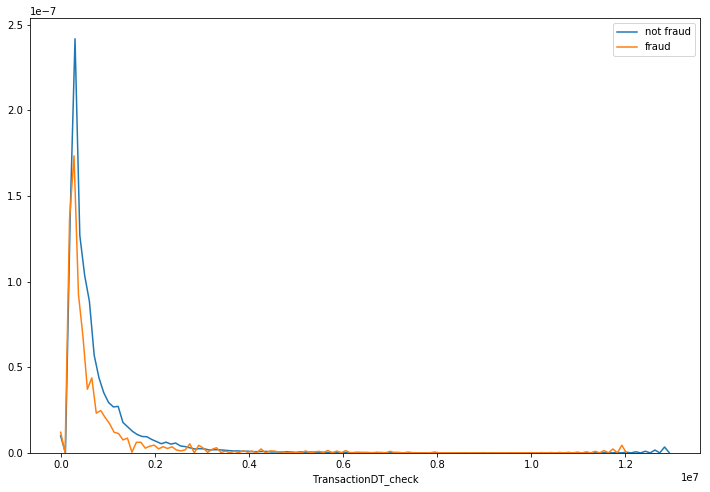

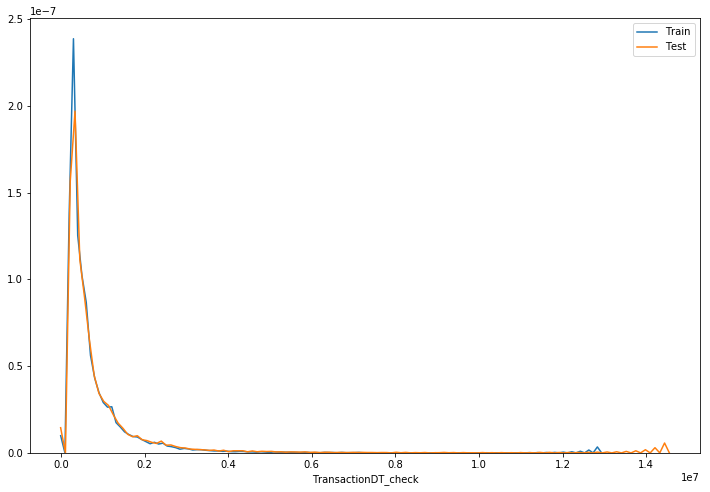

In [944]:
plt.figure(figsize=(12,8))

sns.distplot(train[(train['TransactionDT_check'].isna()==False) & (train[train['TransactionDT_check'].isna()==False]['isFraud'] == 0)]['TransactionDT_check'], hist=False, label='not fraud')
sns.distplot(train[(train['TransactionDT_check'].isna()==False) & (train[train['TransactionDT_check'].isna()==False]['isFraud'] == 1)]['TransactionDT_check'], hist=False, label='fraud')

plt.legend()

plt.figure(figsize=(12,8))

sns.distplot(train[train['TransactionDT_check'].isna()==False]['TransactionDT_check'], hist=False, label='Train')
sns.distplot(test[test['TransactionDT_check'].isna()==False]['TransactionDT_check'], hist=False, label='Test')

plt.legend()

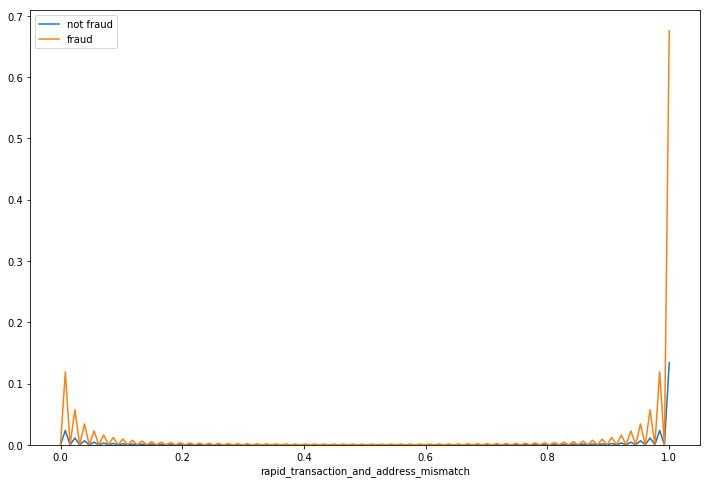

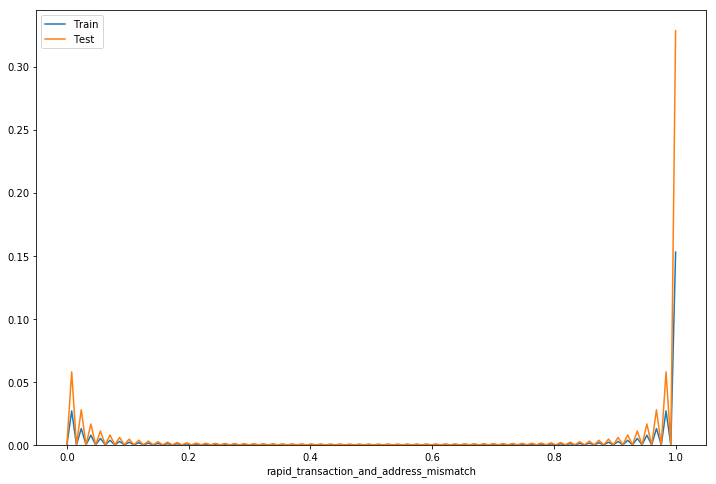

In [946]:
plt.figure(figsize=(12,8))

sns.distplot(train[(train['rapid_transaction_and_address_mismatch'].isna()==False) & (train[train['rapid_transaction_and_address_mismatch'].isna()==False]['isFraud'] == 0)]['rapid_transaction_and_address_mismatch'], hist=False, label='not fraud')
sns.distplot(train[(train['rapid_transaction_and_address_mismatch'].isna()==False) & (train[train['rapid_transaction_and_address_mismatch'].isna()==False]['isFraud'] == 1)]['rapid_transaction_and_address_mismatch'], hist=False, label='fraud')

plt.legend()

plt.figure(figsize=(12,8))

sns.distplot(train[train['rapid_transaction_and_address_mismatch'].isna()==False]['rapid_transaction_and_address_mismatch'], hist=False, label='Train')
sns.distplot(test[test['rapid_transaction_and_address_mismatch'].isna()==False]['rapid_transaction_and_address_mismatch'], hist=False, label='Test')

plt.legend()

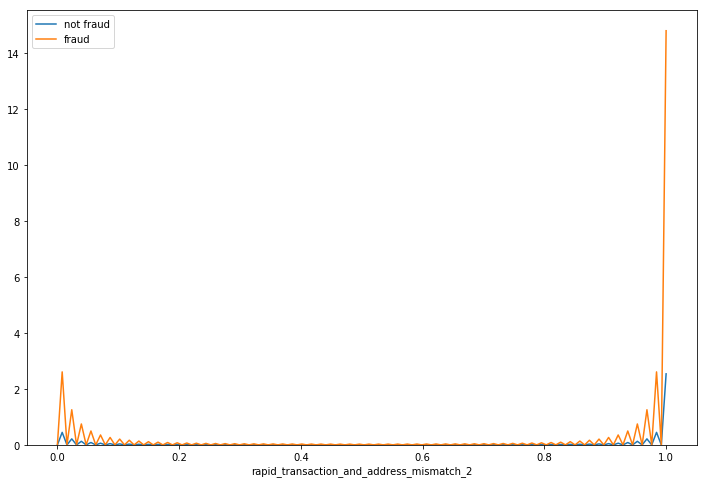

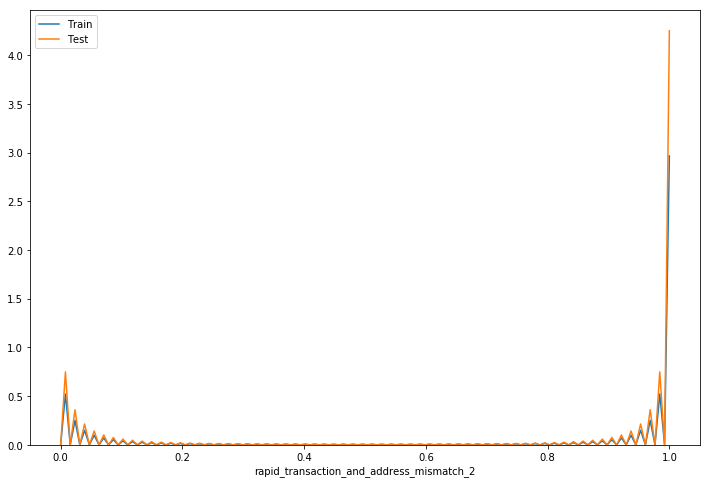

In [947]:
plt.figure(figsize=(12,8))

sns.distplot(train[(train['rapid_transaction_and_address_mismatch_2'].isna()==False) & (train[train['rapid_transaction_and_address_mismatch_2'].isna()==False]['isFraud'] == 0)]['rapid_transaction_and_address_mismatch_2'], hist=False, label='not fraud')
sns.distplot(train[(train['rapid_transaction_and_address_mismatch_2'].isna()==False) & (train[train['rapid_transaction_and_address_mismatch_2'].isna()==False]['isFraud'] == 1)]['rapid_transaction_and_address_mismatch_2'], hist=False, label='fraud')

plt.legend()

plt.figure(figsize=(12,8))

sns.distplot(train[train['rapid_transaction_and_address_mismatch_2'].isna()==False]['rapid_transaction_and_address_mismatch_2'], hist=False, label='Train')
sns.distplot(test[test['rapid_transaction_and_address_mismatch_2'].isna()==False]['rapid_transaction_and_address_mismatch_2'], hist=False, label='Test')

plt.legend()

In [949]:
from sklearn.preprocessing import LabelEncoder

for col in ['rapid_transaction_and_address_mismatch','rapid_transaction_and_address_mismatch_2']:
    print(col)
    sampled_train[col] = sampled_train[col].fillna('unseen_before_label')
    train[col] = train[col].fillna('unseen_before_label')
    test[col]  = test[col].fillna('unseen_before_label')

    sampled_train[col] = sampled_train[col].astype(str)
    train[col] = train[col].astype(str)
    test[col] = test[col].astype(str)

    le = LabelEncoder()
    le.fit(list(train[col])+list(test[col]))
    sampled_train[col] = le.transform(sampled_train[col])
    train[col] = le.transform(train[col])
    test[col] = le.transform(test[col])

rapid_transaction_and_address_mismatch
rapid_transaction_and_address_mismatch_2


In [987]:
# Create correlation matrix
corr_matrix = sampled_train.corr().abs()

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# Find index of feature columns with correlation greater than 0.95
to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]

In [989]:
corr_matrix

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V15,V16,V17,V18,V19,V20,V21,V22,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V56,V57,V58,V59,V60,V61,V62,V63,V64,V69,V70,V71,V72,V73,V74,V75,V76,V78,V79,V80,V81,V82,V83,V84,V85,V87,V90,V91,V92,V93,V94,V95,V96,V97,V99,V100,V126,V127,V128,V130,V131,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V282,V283,V285,V287,V288,V289,V291,V292,V294,V302,V303,V304,V306,V307,V308,V310,V312,V313,V314,V315,V317,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek,DeviceInfo_device,id_30_device,id_30_version,id_31_device,M_mean,M_sum,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card3_TransactionAmt_std,card5_TransactionAmt_mean,card5_TransactionAmt_std,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_TransactionAmt_mean_over_4.0_month(s),card1_TransactionAmt_std_over_4.0_month(s),card1_TransactionAmt_mean_over_5.0_month(s),card1_TransactionAmt_std_over_5.0_month(s),card1_TransactionAmt_mean_over_6.0_month(s),card1_TransactionAmt_std_over_6.0_month(s),card1_TransactionAmt_mean_over_7.0_month(s),card1_TransactionAmt_std_over_7.0_month(s),card1_TransactionAmt_mean_over_8.0_month(s),card1_TransactionAmt_std_over_8.0_month(s),card1_TransactionAmt_mean_over_9.0_month(s),card1_TransactionAmt_std_over_9.0_month(s),card1_TransactionAmt_mean_over_10.0_month(s),card1_TransactionAmt_std_over_10.0_month(s),card1_TransactionAmt_mean_over_11.0_month(s),card1_TransactionAmt_std_over_11.0_month(s),card1_TransactionAmt_mean_over_12.0_month(s),card1_TransactionAmt_std_over_12.0_month(s),card1_TransactionAmt_mean_over_13.0_month(s),card1_TransactionAmt_std_over_13.0_month(s),card1_TransactionAmt_mean_over_14.0_month(s),card1_TransactionAmt_std_over_14.0_month(s),card1_fq_enc,card2_fq_enc,card3_fq_enc,card5_fq_enc,C1_fq_enc,C2_fq_enc,C4_fq_enc,C5_fq_enc,C6_fq_enc,C7_fq_enc,C8_fq_enc,C9_fq_enc,C10_fq_enc,C11_fq_enc,C12_fq_enc,C13_fq_enc,C14_fq_enc,D1_fq_enc,D2_fq_enc,D3_fq_enc,D4_fq_enc,D5_fq_enc,D6_fq_enc,D8_fq_enc,D9_fq_enc,addr1_fq_enc,dist1_fq_enc,P_emaildomain_fq_enc,R_emaildomain_fq_enc,DeviceType_fq_enc,DeviceInfo_fq_enc,DeviceInfo_device_fq_enc,id_30_fq_enc,id_30_device_fq_enc,id_30_version_fq_enc,id_31_device_fq_enc,id_33_fq_enc,uid_fq_enc,uid2_fq_enc,bank_type,address_match,TransactionDT_check,rapid_transaction_and_address_mismatch,rapid_transaction_and_address_mismatch_2,address_match_2
TransactionID,1.000000,0.010038,0.998387,0.007516,0.11066

In [990]:
upper

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,P_emaildomain,R_emaildomain,C1,C2,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V15,V16,V17,V18,V19,V20,V21,V22,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V56,V57,V58,V59,V60,V61,V62,V63,V64,V69,V70,V71,V72,V73,V74,V75,V76,V78,V79,V80,V81,V82,V83,V84,V85,V87,V90,V91,V92,V93,V94,V95,V96,V97,V99,V100,V126,V127,V128,V130,V131,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V282,V283,V285,V287,V288,V289,V291,V292,V294,V302,V303,V304,V306,V307,V308,V310,V312,V313,V314,V315,V317,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo,TransactionWeek,DeviceInfo_device,id_30_device,id_30_version,id_31_device,M_mean,M_sum,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card3_TransactionAmt_std,card5_TransactionAmt_mean,card5_TransactionAmt_std,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_TransactionAmt_mean_over_4.0_month(s),card1_TransactionAmt_std_over_4.0_month(s),card1_TransactionAmt_mean_over_5.0_month(s),card1_TransactionAmt_std_over_5.0_month(s),card1_TransactionAmt_mean_over_6.0_month(s),card1_TransactionAmt_std_over_6.0_month(s),card1_TransactionAmt_mean_over_7.0_month(s),card1_TransactionAmt_std_over_7.0_month(s),card1_TransactionAmt_mean_over_8.0_month(s),card1_TransactionAmt_std_over_8.0_month(s),card1_TransactionAmt_mean_over_9.0_month(s),card1_TransactionAmt_std_over_9.0_month(s),card1_TransactionAmt_mean_over_10.0_month(s),card1_TransactionAmt_std_over_10.0_month(s),card1_TransactionAmt_mean_over_11.0_month(s),card1_TransactionAmt_std_over_11.0_month(s),card1_TransactionAmt_mean_over_12.0_month(s),card1_TransactionAmt_std_over_12.0_month(s),card1_TransactionAmt_mean_over_13.0_month(s),card1_TransactionAmt_std_over_13.0_month(s),card1_TransactionAmt_mean_over_14.0_month(s),card1_TransactionAmt_std_over_14.0_month(s),card1_fq_enc,card2_fq_enc,card3_fq_enc,card5_fq_enc,C1_fq_enc,C2_fq_enc,C4_fq_enc,C5_fq_enc,C6_fq_enc,C7_fq_enc,C8_fq_enc,C9_fq_enc,C10_fq_enc,C11_fq_enc,C12_fq_enc,C13_fq_enc,C14_fq_enc,D1_fq_enc,D2_fq_enc,D3_fq_enc,D4_fq_enc,D5_fq_enc,D6_fq_enc,D8_fq_enc,D9_fq_enc,addr1_fq_enc,dist1_fq_enc,P_emaildomain_fq_enc,R_emaildomain_fq_enc,DeviceType_fq_enc,DeviceInfo_fq_enc,DeviceInfo_device_fq_enc,id_30_fq_enc,id_30_device_fq_enc,id_30_version_fq_enc,id_31_device_fq_enc,id_33_fq_enc,uid_fq_enc,uid2_fq_enc,bank_type,address_match,TransactionDT_check,rapid_transaction_and_address_mismatch,rapid_transaction_and_address_mismatch_2,address_match_2
TransactionID,NaN,0.010038,0.998387,0.007516,0.110662,0.0

In [988]:
to_drop

['TransactionDT',
 'C2',
 'C4',
 'C6',
 'C8',
 'C10',
 'C11',
 'C12',
 'C14',
 'D2',
 'D6',
 'D12',
 'V11',
 'V15',
 'V16',
 'V18',
 'V22',
 'V30',
 'V32',
 'V33',
 'V34',
 'V43',
 'V49',
 'V50',
 'V52',
 'V57',
 'V58',
 'V63',
 'V70',
 'V71',
 'V72',
 'V74',
 'V81',
 'V84',
 'V91',
 'V92',
 'V93',
 'V94',
 'V97',
 'V126',
 'V127',
 'V128',
 'V143',
 'V145',
 'V150',
 'V151',
 'V154',
 'V155',
 'V156',
 'V159',
 'V160',
 'V163',
 'V164',
 'V167',
 'V168',
 'V177',
 'V178',
 'V179',
 'V182',
 'V183',
 'V192',
 'V193',
 'V196',
 'V202',
 'V204',
 'V211',
 'V212',
 'V213',
 'V217',
 'V218',
 'V219',
 'V222',
 'V231',
 'V232',
 'V233',
 'V235',
 'V236',
 'V237',
 'V244',
 'V249',
 'V251',
 'V254',
 'V256',
 'V263',
 'V265',
 'V266',
 'V269',
 'V272',
 'V273',
 'V275',
 'V276',
 'V277',
 'V278',
 'V279',
 'V280',
 'V292',
 'V294',
 'V304',
 'V306',
 'V307',
 'V308',
 'V317',
 'V322',
 'V323',
 'V324',
 'V326',
 'V327',
 'V329',
 'V330',
 'V331',
 'V332',
 'V333',
 'V336',
 'id_16',
 'id_28'

# Splitting into train, val, and test

In [991]:
X = sampled_train

In [992]:
len(features_to_drop)

100

In [993]:
len(features_to_drop_2)

196

In [994]:
X.shape

(462725, 445)

In [995]:
y = sampled_train['isFraud']

X = sampled_train.drop(['TransactionID', 'TransactionDT', 'TransactionWeek',
            'uid','uid2', 'bank_type',
            'DeviceInfo','DeviceInfo_device',
            'id_30','id_30_device','id_30_version',
            'id_31','id_31_device', 'id_33',
            'D1','D2','D3','D4','D5','D6','D8','D9', 'address_match_2',
            'isFraud'
            ]
            + features_to_drop +  features_to_drop_2 + to_drop, axis=1)

In [996]:
X.head()

,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,dist1,P_emaildomain,R_emaildomain,C1,C5,C9,C13,D10,D11,D13,D14,D15,M2,M3,M4,M5,M6,M7,M8,M9,V4,V5,V6,V7,V12,V13,V19,V20,V29,V35,V36,V37,V38,V44,V45,V47,V48,V53,V54,V56,V61,V62,V75,V76,V78,V82,V83,V87,V90,V96,V99,V130,V131,V139,V149,V152,V162,V165,V187,V189,V201,V203,V205,V206,V207,V208,V209,V210,V215,V220,V234,V257,V258,V261,V264,V267,V268,V271,V274,V282,V283,V285,V288,V291,V310,V312,V313,V314,V315,V338,id_01,id_02,id_03,id_05,id_06,id_09,id_13,id_14,id_17,id_19,id_20,id_38,M_mean,M_sum,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card5_TransactionAmt_mean,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_fq_enc,card2_fq_enc,card5_fq_enc,C1_fq_enc,C2_fq_enc,C5_fq_enc,C6_fq_enc,C9_fq_enc,C11_fq_enc,C12_fq_enc,C13_fq_enc,C14_fq_enc,D1_fq_enc,D2_fq_enc,D3_fq_enc,D4_fq_enc,D5_fq_enc,D8_fq_enc,D9_fq_enc,addr1_fq_enc,dist1_fq_enc,P_emaildomain_fq_enc,DeviceInfo_fq_enc,id_30_fq_enc,uid2_fq_enc,address_match,TransactionDT_check,rapid_transaction_and_address_mismatch,rapid_transaction_and_address_mismatch_2
0,3.295096,0,4461.0,375.0,185.0,2,224.0,2,NaN,NaN,16,16,1.0,0.0,0.0,1.0,0.0,NaN,0.0,0.0,0.0,2,2,2,2,2,2,2,2,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.0,1.0,1.0,0.0,0.0,1.0,0.00,0.00,0.00,0.00,0.00,NaN,0.0,334122.0,NaN,0.0,0.0,NaN,NaN,NaN,225.0,266.0,325.0,1,2,16,0,35.414248,36.308320,40.112289,109.731050,36.317799,36.767041,35.421336,35.632563,45.626353,38.577980,42.842794,36.380943,40.320138,34.339101,5959.0,12157.0,153109.0,586742,581696,707008,631237,341561,731792,185008,367617,598520,507854.0,NaN,NaN,344849.0,NaN,NaN,NaN,NaN,NaN,435803,131,949007,5632,NaN,NaN,0,0
1,5.525453,2,13979.0,474.0,150.0,4,226.0,1,476.0,NaN,55,1,1.0,0.0,0.0,1.0,0.0,NaN,NaN,0.0,0.0,2,2,3,2,2,2,2,2,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.0,1.0,1.0,0.0,0.0,1.0,0.00,0.00,0.00,0.00,0.00,0.0,-5.0,100657.0,NaN,0.0,0.0,NaN,49.0,-300.0,166.0,312.0,278.0,0,2,16,1,171.579333,239.189969,147.654107,141.866634,168.267440,148.877895,250.000000,NaN,103.690345,66.986060,131.639750,100.376258,154.625636,125.264033,168.0,750.0,553537.0,586742,581696,707008,631237,341561,731792,856080,367617,598520,507854.0,NaN,NaN,344849.0,NaN,NaN,NaN,17455.0,NaN,182784,23722,2575,1,0.991406,NaN,0,0
2,4.639572,0,12451.0,213.0,117.0,2,126.0,2,NaN,NaN,16,16,1.0,0.0,0.0,2.0,0.0,NaN,0.0,0.0,0.0,2,2,0,2,2,2,2,2,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,0.0,0.0,0.0,2.0,2.0,1.0,1.0,1.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,0.0,2.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,93.7718,93.75,93.75,93.75,93.75,93.75,93.75,0.0,1.0,0.0,1.0,1.0,1.0,93.7718,93.75,93.75,93.75,0.0,2.0,2.0,1.0,1.0,2.0,93.75,93.75,93.75,93.75,93.75,NaN,-5.0,133430.0,0.0,0.0,-13.0,0.0,52.0,NaN,121.0,410.0,142.0,1,2,16,1,53.290215,40.692032,51.905759,103.716680,45.208968,39.256352,40.495643,38.348188,50.075500,30.981172,44.945833,30.568373,40.392690,29.897803,32.0,158.0,21737.0,586742,197032,707008,631237,341561,731792,185008,107563,598520,507854.0,27068.0,146326.0,344849.0,139264.0,496.0,2624.0,NaN,NaN,435803,92710,949007,28,NaN,NaN,0,0
3,3.433987,4,5618.0,390.0,150.0,2,224.0,2,315.0,NaN,55,49,1.0,0.0,1.0,8.0,51.0,NaN,NaN,NaN,NaN,2,2,0,1,0,2,2,2,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,NaN,NaN,NaN,N

In [997]:
X.shape

(462725, 157)

In [998]:
tscv = TimeSeriesSplit(n_splits=num_folds,
                       test_size=n_days_in_week_21,
                       delay=n_days_in_week_21)

In [999]:
tscv

TimeSeriesSplit(delay=18509, force_step_size=None, n_splits=5,
        test_size=18509, train_size=None)

In [1000]:
X.head()

,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,dist1,P_emaildomain,R_emaildomain,C1,C5,C9,C13,D10,D11,D13,D14,D15,M2,M3,M4,M5,M6,M7,M8,M9,V4,V5,V6,V7,V12,V13,V19,V20,V29,V35,V36,V37,V38,V44,V45,V47,V48,V53,V54,V56,V61,V62,V75,V76,V78,V82,V83,V87,V90,V96,V99,V130,V131,V139,V149,V152,V162,V165,V187,V189,V201,V203,V205,V206,V207,V208,V209,V210,V215,V220,V234,V257,V258,V261,V264,V267,V268,V271,V274,V282,V283,V285,V288,V291,V310,V312,V313,V314,V315,V338,id_01,id_02,id_03,id_05,id_06,id_09,id_13,id_14,id_17,id_19,id_20,id_38,M_mean,M_sum,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card5_TransactionAmt_mean,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_fq_enc,card2_fq_enc,card5_fq_enc,C1_fq_enc,C2_fq_enc,C5_fq_enc,C6_fq_enc,C9_fq_enc,C11_fq_enc,C12_fq_enc,C13_fq_enc,C14_fq_enc,D1_fq_enc,D2_fq_enc,D3_fq_enc,D4_fq_enc,D5_fq_enc,D8_fq_enc,D9_fq_enc,addr1_fq_enc,dist1_fq_enc,P_emaildomain_fq_enc,DeviceInfo_fq_enc,id_30_fq_enc,uid2_fq_enc,address_match,TransactionDT_check,rapid_transaction_and_address_mismatch,rapid_transaction_and_address_mismatch_2
0,3.295096,0,4461.0,375.0,185.0,2,224.0,2,NaN,NaN,16,16,1.0,0.0,0.0,1.0,0.0,NaN,0.0,0.0,0.0,2,2,2,2,2,2,2,2,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.0,1.0,1.0,0.0,0.0,1.0,0.00,0.00,0.00,0.00,0.00,NaN,0.0,334122.0,NaN,0.0,0.0,NaN,NaN,NaN,225.0,266.0,325.0,1,2,16,0,35.414248,36.308320,40.112289,109.731050,36.317799,36.767041,35.421336,35.632563,45.626353,38.577980,42.842794,36.380943,40.320138,34.339101,5959.0,12157.0,153109.0,586742,581696,707008,631237,341561,731792,185008,367617,598520,507854.0,NaN,NaN,344849.0,NaN,NaN,NaN,NaN,NaN,435803,131,949007,5632,NaN,NaN,0,0
1,5.525453,2,13979.0,474.0,150.0,4,226.0,1,476.0,NaN,55,1,1.0,0.0,0.0,1.0,0.0,NaN,NaN,0.0,0.0,2,2,3,2,2,2,2,2,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.0,1.0,1.0,0.0,0.0,1.0,0.00,0.00,0.00,0.00,0.00,0.0,-5.0,100657.0,NaN,0.0,0.0,NaN,49.0,-300.0,166.0,312.0,278.0,0,2,16,1,171.579333,239.189969,147.654107,141.866634,168.267440,148.877895,250.000000,NaN,103.690345,66.986060,131.639750,100.376258,154.625636,125.264033,168.0,750.0,553537.0,586742,581696,707008,631237,341561,731792,856080,367617,598520,507854.0,NaN,NaN,344849.0,NaN,NaN,NaN,17455.0,NaN,182784,23722,2575,1,0.991406,NaN,0,0
2,4.639572,0,12451.0,213.0,117.0,2,126.0,2,NaN,NaN,16,16,1.0,0.0,0.0,2.0,0.0,NaN,0.0,0.0,0.0,2,2,0,2,2,2,2,2,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,0.0,0.0,0.0,2.0,2.0,1.0,1.0,1.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,0.0,2.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,93.7718,93.75,93.75,93.75,93.75,93.75,93.75,0.0,1.0,0.0,1.0,1.0,1.0,93.7718,93.75,93.75,93.75,0.0,2.0,2.0,1.0,1.0,2.0,93.75,93.75,93.75,93.75,93.75,NaN,-5.0,133430.0,0.0,0.0,-13.0,0.0,52.0,NaN,121.0,410.0,142.0,1,2,16,1,53.290215,40.692032,51.905759,103.716680,45.208968,39.256352,40.495643,38.348188,50.075500,30.981172,44.945833,30.568373,40.392690,29.897803,32.0,158.0,21737.0,586742,197032,707008,631237,341561,731792,185008,107563,598520,507854.0,27068.0,146326.0,344849.0,139264.0,496.0,2624.0,NaN,NaN,435803,92710,949007,28,NaN,NaN,0,0
3,3.433987,4,5618.0,390.0,150.0,2,224.0,2,315.0,NaN,55,49,1.0,0.0,1.0,8.0,51.0,NaN,NaN,NaN,NaN,2,2,0,1,0,2,2,2,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,NaN,NaN,NaN,N

In [1001]:
X.shape

(462725, 157)

# Train LightGBM

In [1002]:
# Create arrays for oof predictions and sub predictions
val_auc_scores = []

In [1003]:
feature_importance_df = pd.DataFrame(columns = ['feature', 'importance'])

In [1004]:
X.shape

(462725, 157)

In [1005]:
from time import time

n_fold = 1

start = time()
X['isFraud'] = y

for train_index, val_index in tscv.split(X):
    print("TRAIN:", train_index, "TEST:", val_index)
    X_train, X_val = X.iloc[train_index], X.iloc[val_index]
    y_train, y_val = y.iloc[train_index], y.iloc[val_index]
                                                 
    
    for col in ['ProductCD', 'M4']:
        temp_dict_train = X_train.groupby([col])['isFraud'].agg(['mean']).reset_index().rename(
                                                            columns={'mean': col+'_target_mean'})
        temp_dict_val = X_val.groupby([col])['isFraud'].agg(['mean']).reset_index().rename(
                                                            columns={'mean': col+'_target_mean'})
        
        temp_dict_train.index = temp_dict_train[col].values
        temp_dict_val.index = temp_dict_val[col].values
        
        temp_dict_train = temp_dict_train[col+'_target_mean'].to_dict()
        temp_dict_val = temp_dict_val[col+'_target_mean'].to_dict()

        X_train[col+'_target_mean'] = X_train[col].map(temp_dict_train)
        X_val[col+'_target_mean'] = X_val[col].map(temp_dict_val)
        
    X_train = X_train.drop('isFraud', axis=1)
    X_val = X_val.drop('isFraud', axis=1)
    
    trn_data = lgb.Dataset(X_train, label=y_train)
    val_data = lgb.Dataset(X_val, label=y_val)
    
    clf = lgb.train(params, trn_data, valid_sets=[trn_data, val_data], verbose_eval=50)
    
    val_preds = clf.predict(X_val, num_iteration=clf.best_iteration)    
    val_auc = roc_auc_score(y_val.values, val_preds)
    print('AUROC on validation fold {}: {}'.format(n_fold, val_auc))
    val_auc_scores.append(val_auc)

    n_fold += 1
    
end = time()

TRAIN: [     0      1      2 ... 117224 117225 117226] TEST: [135736 135737 135738 ... 154242 154243 154244]


/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/lightgbm/engine.py:113: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[50]	training's auc: 0.95189	valid_1's auc: 0.892862
[100]	training's auc: 0.974325	valid_1's auc: 0.905538
[150]	training's auc: 0.987853	valid_1's auc: 0.914216
[200]	training's auc: 0.99419	valid_1's auc: 0.917996
[250]	training's auc: 0.997397	valid_1's auc: 0.918839
[300]	training's auc: 0.998959	valid_1's auc: 0.918341
[350]	training's auc: 0.999598	valid_1's auc: 0.918803
[400]	training's auc: 0.999834	valid_1's auc: 0.918347
[450]	training's auc: 0.999931	valid_1's auc: 0.917997
[500]	training's auc: 0.999972	valid_1's auc: 0.91813
[550]	training's auc: 0.99999	valid_1's auc: 0.918198
AUROC on validation fold 1: 0.9181978578467906
TRAIN: [     0      1      2 ... 194344 194345 194346] TEST: [212856 212857 212858 ... 231362 231363 231364]


/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/lightgbm/engine.py:113: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[50]	training's auc: 0.935289	valid_1's auc: 0.894225
[100]	training's auc: 0.959064	valid_1's auc: 0.900746
[150]	training's auc: 0.972947	valid_1's auc: 0.908626
[200]	training's auc: 0.982908	valid_1's auc: 0.914084
[250]	training's auc: 0.989766	valid_1's auc: 0.917562
[300]	training's auc: 0.993907	valid_1's auc: 0.920345
[350]	training's auc: 0.99643	valid_1's auc: 0.922828
[400]	training's auc: 0.997894	valid_1's auc: 0.923728
[450]	training's auc: 0.998757	valid_1's auc: 0.924231
[500]	training's auc: 0.999261	valid_1's auc: 0.924382
[550]	training's auc: 0.99957	valid_1's auc: 0.924591
AUROC on validation fold 2: 0.9245908231525113
TRAIN: [     0      1      2 ... 271464 271465 271466] TEST: [289976 289977 289978 ... 308482 308483 308484]


/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/lightgbm/engine.py:113: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[50]	training's auc: 0.927623	valid_1's auc: 0.888438
[100]	training's auc: 0.944441	valid_1's auc: 0.894296
[150]	training's auc: 0.96244	valid_1's auc: 0.899946
[200]	training's auc: 0.974246	valid_1's auc: 0.906159
[250]	training's auc: 0.982032	valid_1's auc: 0.91242
[300]	training's auc: 0.987516	valid_1's auc: 0.916537
[350]	training's auc: 0.991077	valid_1's auc: 0.919788
[400]	training's auc: 0.993636	valid_1's auc: 0.922065
[450]	training's auc: 0.995494	valid_1's auc: 0.923721
[500]	training's auc: 0.996753	valid_1's auc: 0.92482
[550]	training's auc: 0.997728	valid_1's auc: 0.925561
AUROC on validation fold 3: 0.9255607027423908
TRAIN: [     0      1      2 ... 348584 348585 348586] TEST: [367096 367097 367098 ... 385602 385603 385604]


/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/lightgbm/engine.py:113: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[50]	training's auc: 0.9251	valid_1's auc: 0.862471
[100]	training's auc: 0.941081	valid_1's auc: 0.875889
[150]	training's auc: 0.956987	valid_1's auc: 0.892544
[200]	training's auc: 0.96811	valid_1's auc: 0.903135
[250]	training's auc: 0.976372	valid_1's auc: 0.911741
[300]	training's auc: 0.982226	valid_1's auc: 0.918513
[350]	training's auc: 0.986341	valid_1's auc: 0.922732
[400]	training's auc: 0.989429	valid_1's auc: 0.926026
[450]	training's auc: 0.991786	valid_1's auc: 0.928536
[500]	training's auc: 0.993684	valid_1's auc: 0.930084
[550]	training's auc: 0.995168	valid_1's auc: 0.93121
AUROC on validation fold 4: 0.9312098290080038
TRAIN: [     0      1      2 ... 425704 425705 425706] TEST: [444216 444217 444218 ... 462722 462723 462724]


/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/ipykernel_launcher.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/cchadha2/anaconda3/envs/eda/lib/python3.7/site-packages/lightgbm/engine.py:113: UserWarning: Found `n_estimators` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[50]	training's auc: 0.91969	valid_1's auc: 0.888382
[100]	training's auc: 0.939787	valid_1's auc: 0.899695
[150]	training's auc: 0.952351	valid_1's auc: 0.906984
[200]	training's auc: 0.963115	valid_1's auc: 0.915921
[250]	training's auc: 0.972045	valid_1's auc: 0.925874
[300]	training's auc: 0.978223	valid_1's auc: 0.933026
[350]	training's auc: 0.982836	valid_1's auc: 0.938313
[400]	training's auc: 0.986398	valid_1's auc: 0.941903
[450]	training's auc: 0.989075	valid_1's auc: 0.944307
[500]	training's auc: 0.991238	valid_1's auc: 0.946287
[550]	training's auc: 0.992883	valid_1's auc: 0.947885
AUROC on validation fold 5: 0.9478846981945608


In [1007]:
print('Time taken to train and validate: {} seconds'.format(end-start))

Time taken to train and validate: 533.9027349948883 seconds


The following changes change score from top kernel (550 rounds, 100 early stopping, learning rate 0.01):

- 1.6 model with correct lambda, Mean AUC 0.9290968907559563, LB 0.9478
- Removing features correctly and keeping only most important features from RFE 2 (201 feats), Mean AUC 0.9297153049181978
- Aggregating above over all of train and test, Mean AUC 0.9292912298861244, LB 0.9485
- Monthly aggregations for all of previous mean and std features, Mean AUC 0.929444751451873
- Reverting card3 and card5 back to global aggregations and keeping monthly aggregations for others, Mean AUC 0.9299181256304451, LB 0.9481
- Keeping only card1_TransactionAmt_mean and std monthly aggs, adding average amount spent per month (mean and std) for each card1 in past month(s) up to all of train and test, Mean AUC 0.9286091335436348
- Doing card1 monthly aggregation for ProductCD also, Mean AUC 0.9302200375901799
- Max card1 monthly aggregation, Mean AUC 0.929472238771397
- Adding features to check time between transactions per card1 category and differences in address = Mean AUC 0.9307518611877063
- Label encode rapid_transaction_and_address_mismatch and rapid_transaction_and_address_mismatch_2 and remove address_match_2, Mean AUC 0.9303291743305049
- Dropping highly correlated features, Mean AUC 0.9294887821888516

In [1008]:
print('Mean AUC {}'.format(np.mean(val_auc_scores)))

Mean AUC 0.9294887821888516


In [1009]:
val_auc_scores

[0.9181978578467906,
 0.9245908231525113,
 0.9255607027423908,
 0.9312098290080038,
 0.9478846981945608]

In [1010]:
feature_importance_df

,feature,importance


In [1011]:
len(clf.feature_importance())

159

In [1012]:
len(X.columns.tolist() + ['ProductCD_target_mean', 'M4_target_mean'])

160

In [1013]:
X.head()

,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,dist1,P_emaildomain,R_emaildomain,C1,C5,C9,C13,D10,D11,D13,D14,D15,M2,M3,M4,M5,M6,M7,M8,M9,V4,V5,V6,V7,V12,V13,V19,V20,V29,V35,V36,V37,V38,V44,V45,V47,V48,V53,V54,V56,V61,V62,V75,V76,V78,V82,V83,V87,V90,V96,V99,V130,V131,V139,V149,V152,V162,V165,V187,V189,V201,V203,V205,V206,V207,V208,V209,V210,V215,V220,V234,V257,V258,V261,V264,V267,V268,V271,V274,V282,V283,V285,V288,V291,V310,V312,V313,V314,V315,V338,id_01,id_02,id_03,id_05,id_06,id_09,id_13,id_14,id_17,id_19,id_20,id_38,M_mean,M_sum,TransactionAmt_check,card2_TransactionAmt_mean,card2_TransactionAmt_std,card3_TransactionAmt_mean,card5_TransactionAmt_mean,uid_TransactionAmt_mean,uid_TransactionAmt_std,uid2_TransactionAmt_mean,uid2_TransactionAmt_std,card1_TransactionAmt_mean_over_1.0_month(s),card1_TransactionAmt_std_over_1.0_month(s),card1_TransactionAmt_mean_over_2.0_month(s),card1_TransactionAmt_std_over_2.0_month(s),card1_TransactionAmt_mean_over_3.0_month(s),card1_TransactionAmt_std_over_3.0_month(s),card1_fq_enc,card2_fq_enc,card5_fq_enc,C1_fq_enc,C2_fq_enc,C5_fq_enc,C6_fq_enc,C9_fq_enc,C11_fq_enc,C12_fq_enc,C13_fq_enc,C14_fq_enc,D1_fq_enc,D2_fq_enc,D3_fq_enc,D4_fq_enc,D5_fq_enc,D8_fq_enc,D9_fq_enc,addr1_fq_enc,dist1_fq_enc,P_emaildomain_fq_enc,DeviceInfo_fq_enc,id_30_fq_enc,uid2_fq_enc,address_match,TransactionDT_check,rapid_transaction_and_address_mismatch,rapid_transaction_and_address_mismatch_2,isFraud
0,3.295096,0,4461.0,375.0,185.0,2,224.0,2,NaN,NaN,16,16,1.0,0.0,0.0,1.0,0.0,NaN,0.0,0.0,0.0,2,2,2,2,2,2,2,2,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.0,1.0,1.0,0.0,0.0,1.0,0.00,0.00,0.00,0.00,0.00,NaN,0.0,334122.0,NaN,0.0,0.0,NaN,NaN,NaN,225.0,266.0,325.0,1,2,16,0,35.414248,36.308320,40.112289,109.731050,36.317799,36.767041,35.421336,35.632563,45.626353,38.577980,42.842794,36.380943,40.320138,34.339101,5959.0,12157.0,153109.0,586742,581696,707008,631237,341561,731792,185008,367617,598520,507854.0,NaN,NaN,344849.0,NaN,NaN,NaN,NaN,NaN,435803,131,949007,5632,NaN,NaN,0,0,0
1,5.525453,2,13979.0,474.0,150.0,4,226.0,1,476.0,NaN,55,1,1.0,0.0,0.0,1.0,0.0,NaN,NaN,0.0,0.0,2,2,3,2,2,2,2,2,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,1.0,1.0,1.0,0.0000,0.00,0.00,0.00,0.0,1.0,1.0,0.0,0.0,1.0,0.00,0.00,0.00,0.00,0.00,0.0,-5.0,100657.0,NaN,0.0,0.0,NaN,49.0,-300.0,166.0,312.0,278.0,0,2,16,1,171.579333,239.189969,147.654107,141.866634,168.267440,148.877895,250.000000,NaN,103.690345,66.986060,131.639750,100.376258,154.625636,125.264033,168.0,750.0,553537.0,586742,581696,707008,631237,341561,731792,856080,367617,598520,507854.0,NaN,NaN,344849.0,NaN,NaN,NaN,17455.0,NaN,182784,23722,2575,1,0.991406,NaN,0,0,0
2,4.639572,0,12451.0,213.0,117.0,2,126.0,2,NaN,NaN,16,16,1.0,0.0,0.0,2.0,0.0,NaN,0.0,0.0,0.0,2,2,0,2,2,2,2,2,NaN,NaN,NaN,NaN,0.0,0.0,1.0,1.0,0.0,0.0,0.0,2.0,2.0,1.0,1.0,1.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,0.0,2.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,93.7718,93.75,93.75,93.75,93.75,93.75,93.75,0.0,1.0,0.0,1.0,1.0,1.0,93.7718,93.75,93.75,93.75,0.0,2.0,2.0,1.0,1.0,2.0,93.75,93.75,93.75,93.75,93.75,NaN,-5.0,133430.0,0.0,0.0,-13.0,0.0,52.0,NaN,121.0,410.0,142.0,1,2,16,1,53.290215,40.692032,51.905759,103.716680,45.208968,39.256352,40.495643,38.348188,50.075500,30.981172,44.945833,30.568373,40.392690,29.897803,32.0,158.0,21737.0,586742,197032,707008,631237,341561,731792,185008,107563,598520,507854.0,27068.0,146326.0,344849.0,139264.0,496.0,2624.0,NaN,NaN,435803,92710,949007,28,NaN,NaN,0,0,0
3,3.433987,4,5618.0,390.0,150.0,2,224.0,2,315.0,NaN,55,49,1.0,0.0,1.0,8.0,51.0,NaN,NaN,NaN,NaN,2,2,0,1,0,2,2,2,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0

# Feature importances

In [1014]:
# Concatenate fold importances into feature importance dataframe
X = X.drop('isFraud', axis=1)
feature_importance_df["feature"] = X.columns.tolist() + ['ProductCD_target_mean','M4_target_mean']
feature_importance_df["importance"] = clf.feature_importance()
feature_importance_df = feature_importance_df.sort_values('importance', ascending=False)
feature_importance_df = feature_importance_df.reset_index(drop=True)
feature_importance_df.importance = feature_importance_df.importance.astype('int')

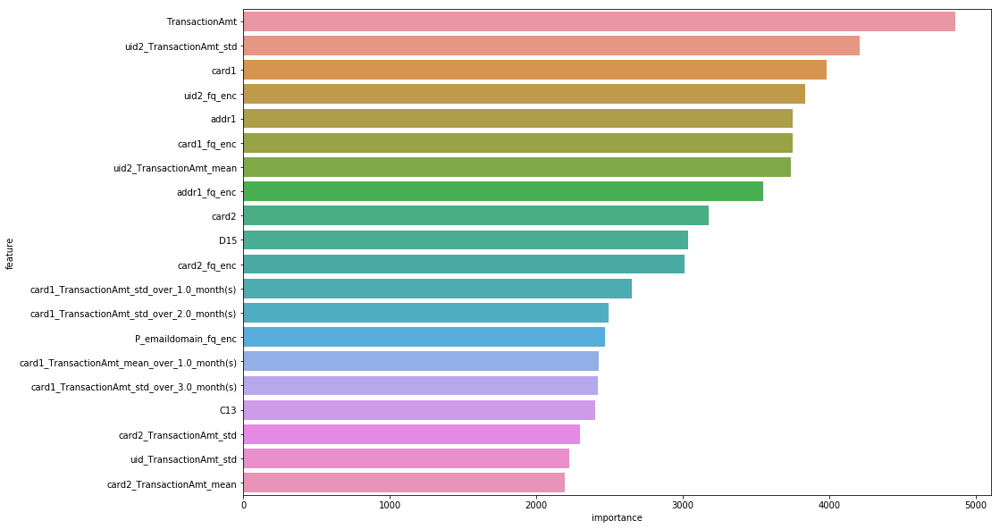

In [1015]:
plt.figure(figsize=(15,10))
sns.barplot(x='importance', y='feature', data=feature_importance_df.head(20))

In [1016]:
feature_importance_df

,feature,importance
0,TransactionAmt,4864
1,uid2_TransactionAmt_std,4208
2,card1,3984
3,uid2_fq_enc,3836
4,addr1,3754
5,card1_fq_enc,3753
6,uid2_TransactionAmt_mean,3742
7,addr1_fq_enc,3548
8,card2,3178
9,D15,3038
